In [2]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns


In [3]:
df = pd.read_csv(r'C:/Users/Admin/Downloads/МН/stroke_data.csv')
df.head()

,sex,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1.0,63.0,0,1,1,4,1,228.69,36.6,1,1
1,1.0,42.0,0,1,1,4,0,105.92,32.5,0,1
2,0.0,61.0,0,0,1,4,1,171.23,34.4,1,1
3,1.0,41.0,1,0,1,3,0,174.12,24.0,0,1
4,1.0,85.0,0,0,1,4,1,186.21,29.0,1,1


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40910 entries, 0 to 40909
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   sex                40907 non-null  float64
 1   age                40910 non-null  float64
 2   hypertension       40910 non-null  int64  
 3   heart_disease      40910 non-null  int64  
 4   ever_married       40910 non-null  int64  
 5   work_type          40910 non-null  int64  
 6   Residence_type     40910 non-null  int64  
 7   avg_glucose_level  40910 non-null  float64
 8   bmi                40910 non-null  float64
 9   smoking_status     40910 non-null  int64  
 10  stroke             40910 non-null  int64  
dtypes: float64(4), int64(7)
memory usage: 3.4 MB


In [5]:
df.isnull().sum()

sex                  3
age                  0
hypertension         0
heart_disease        0
ever_married         0
work_type            0
Residence_type       0
avg_glucose_level    0
bmi                  0
smoking_status       0
stroke               0
dtype: int64

In [6]:
df["sex"].fillna(0, inplace = True)

<Figure size 1500x1000 with 0 Axes>

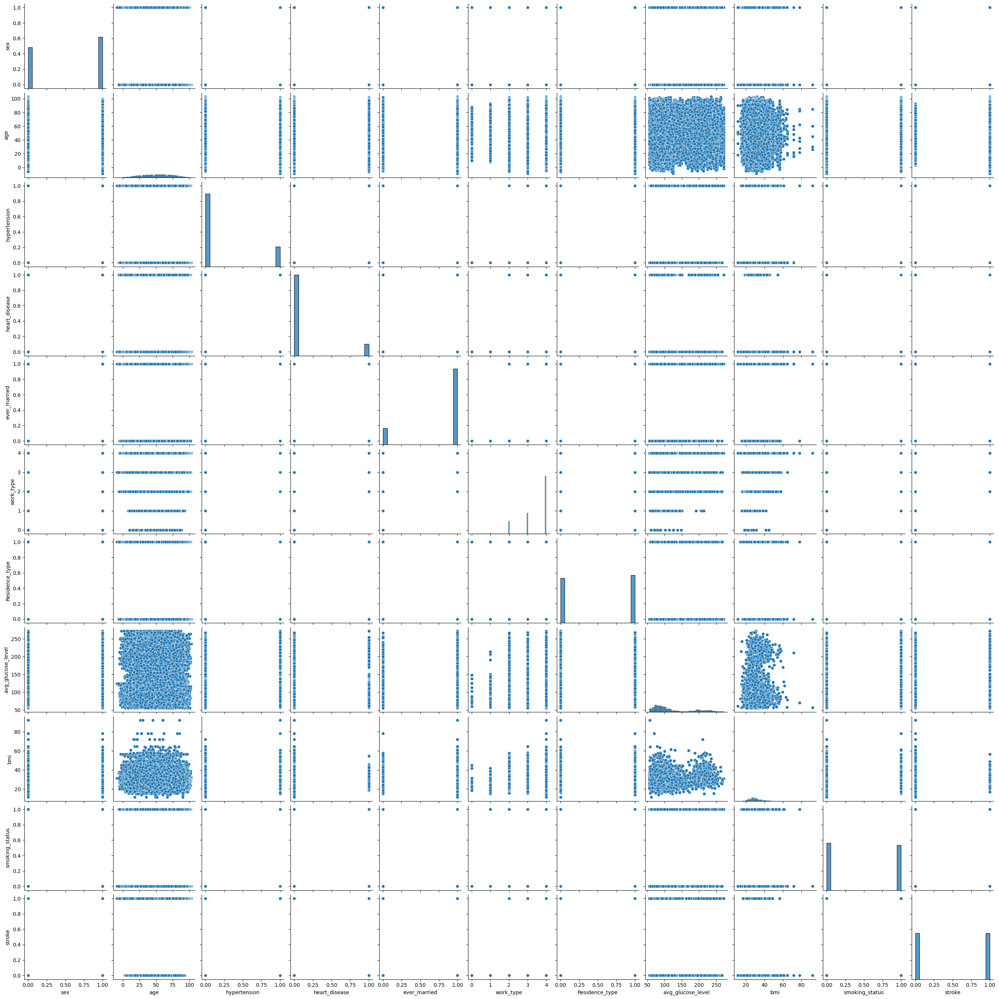

In [7]:
plt.figure(figsize=(15,10))
sns.pairplot(data=df)
plt.show()

   sex   age  hypertension  heart_disease  ever_married  work_type  \
0  1.0  63.0             0              1             1          4   
1  1.0  42.0             0              1             1          4   
2  0.0  61.0             0              0             1          4   
3  1.0  41.0             1              0             1          3   
4  1.0  85.0             0              0             1          4   

   Residence_type  avg_glucose_level   bmi  smoking_status  stroke  
0               1             228.69  36.6               1       1  
1               0             105.92  32.5               0       1  
2               1             171.23  34.4               1       1  
3               0             174.12  24.0               0       1  
4               1             186.21  29.0               1       1  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40910 entries, 0 to 40909
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ---

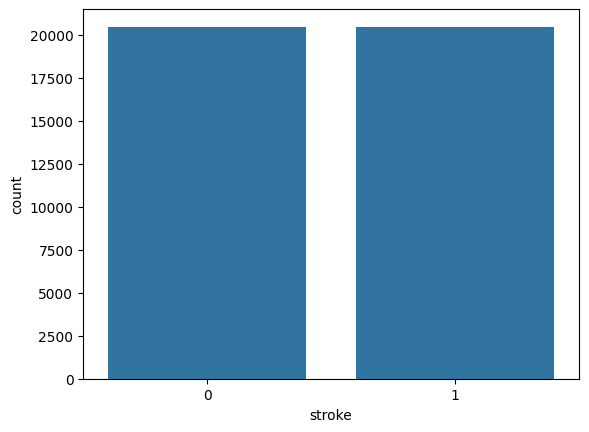

In [8]:

# Первинний аналіз
print(df.head())
print(df.info())
print(df.describe())


sns.countplot(x='stroke', data=df)
plt.show()




In [9]:
df.nunique()

sex                     2
age                   111
hypertension            2
heart_disease           2
ever_married            2
work_type               5
Residence_type          2
avg_glucose_level    2903
bmi                   370
smoking_status          2
stroke                  2
dtype: int64

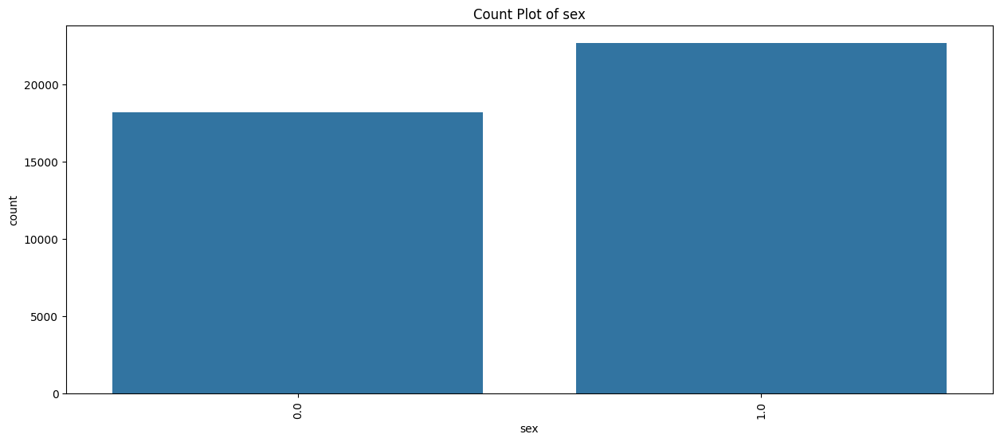

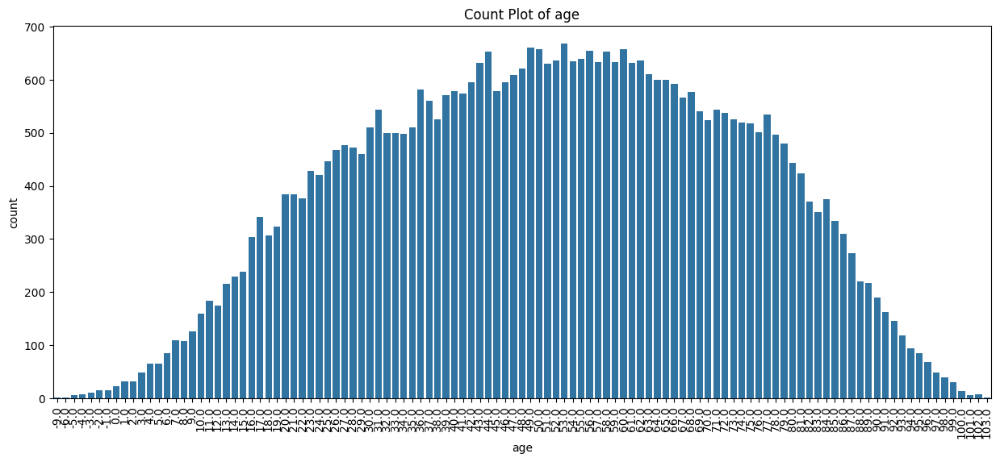

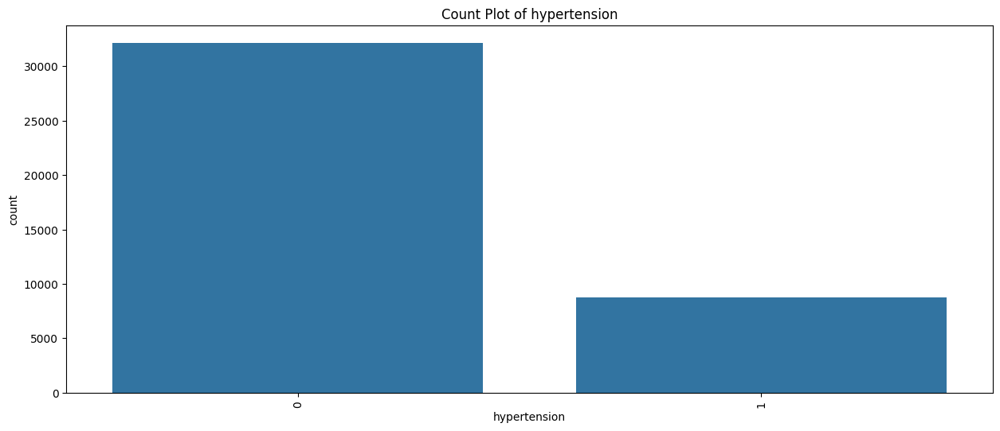

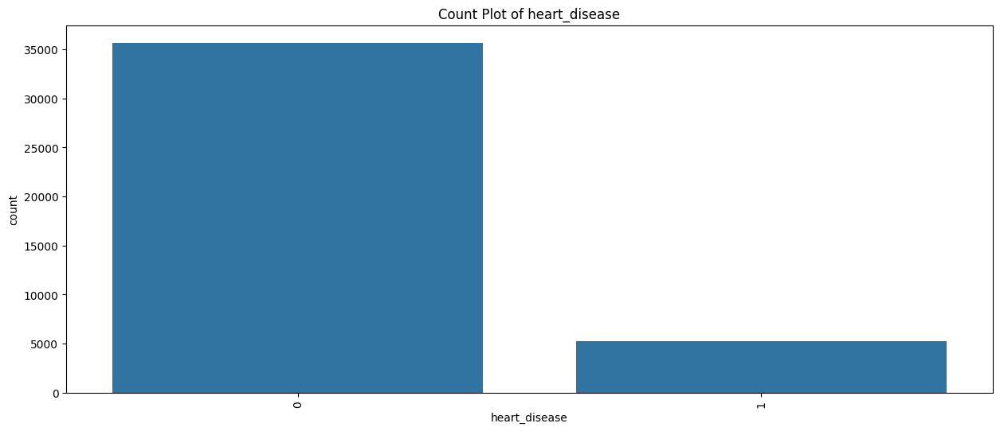

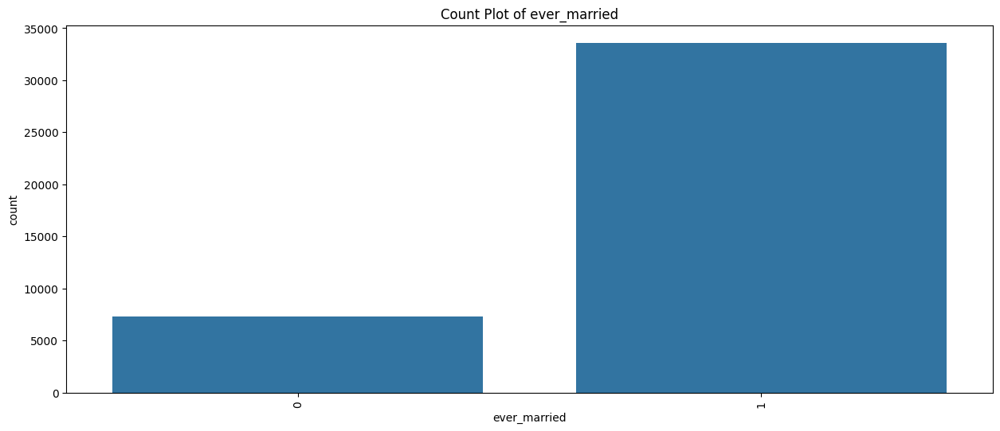

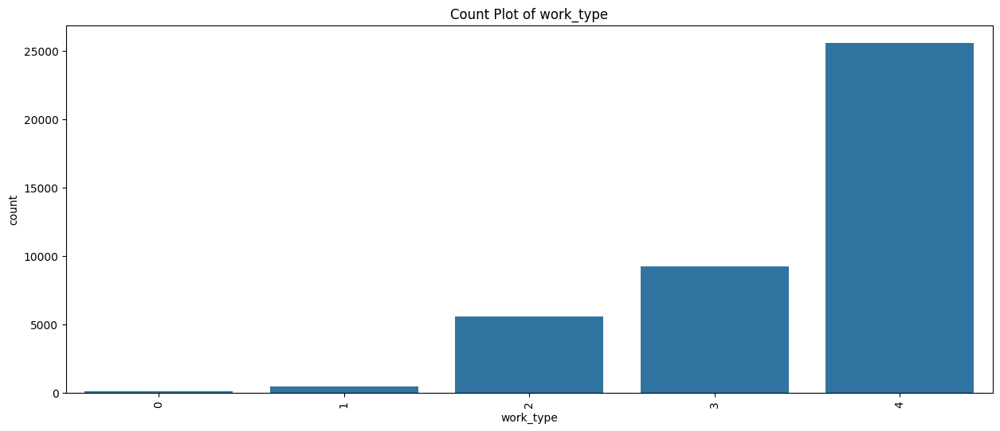

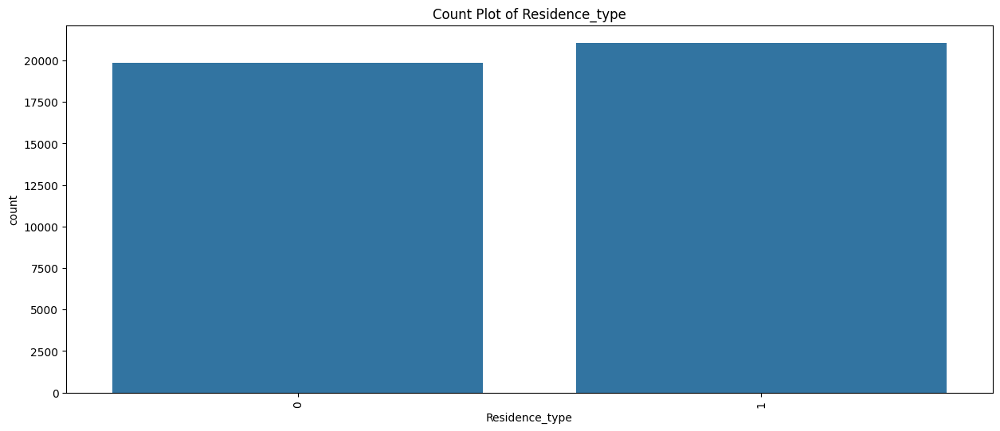

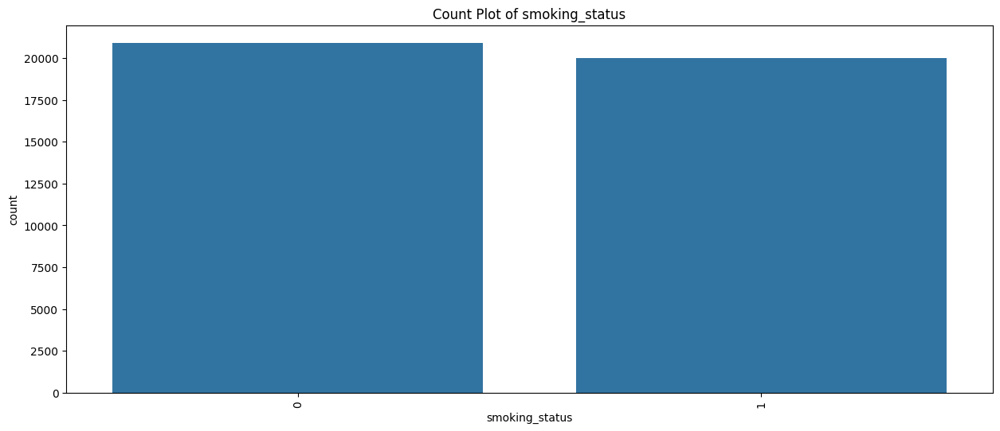

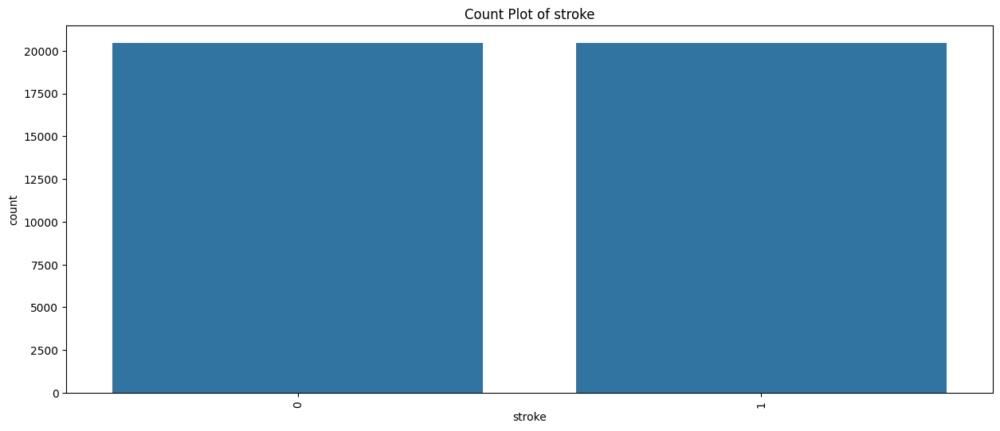

In [10]:
for column in df:
    if column not in ['avg_glucose_level', 'bmi']:
        plt.figure(figsize=(15, 6))
        sns.countplot(x=column, data=df)
        plt.title(f'Count Plot of {column}')
        plt.xticks(rotation=90)
        plt.show()

In [11]:
df = df.drop(df[df.age < 0].index)
len(df.index)


40852

In [12]:
df.loc[df['age'] < 5, 'smoking_status'] = 0

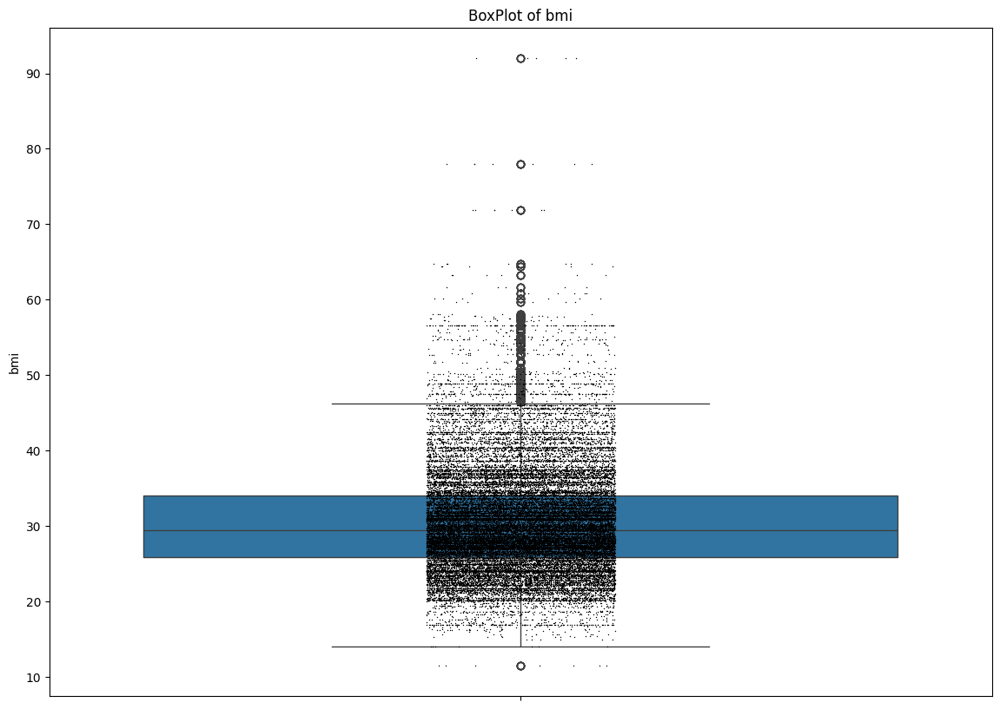

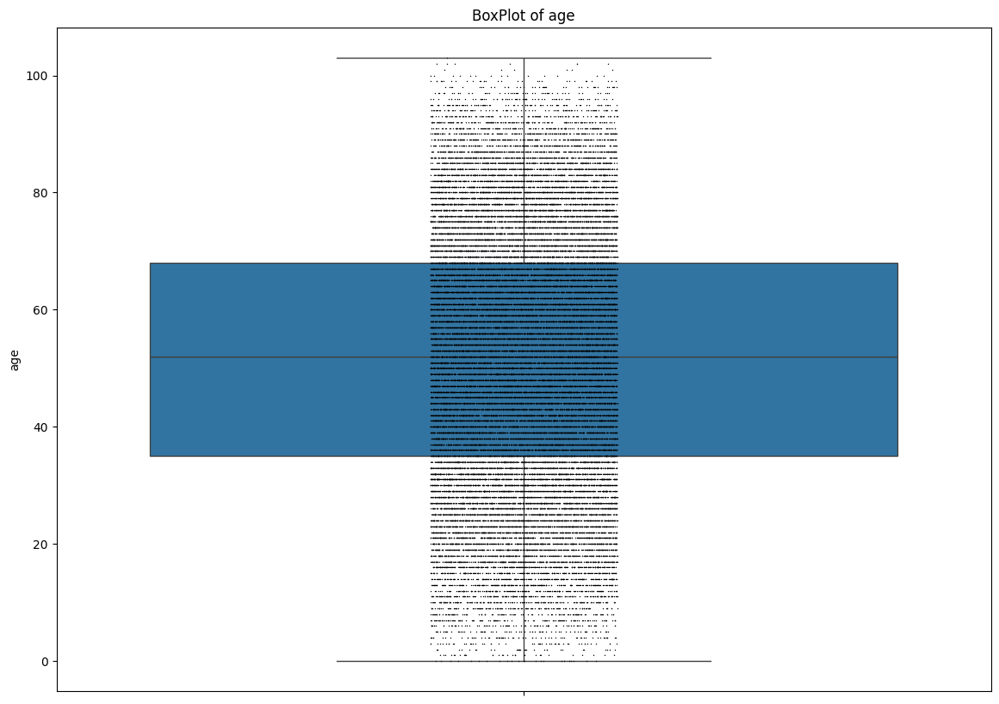

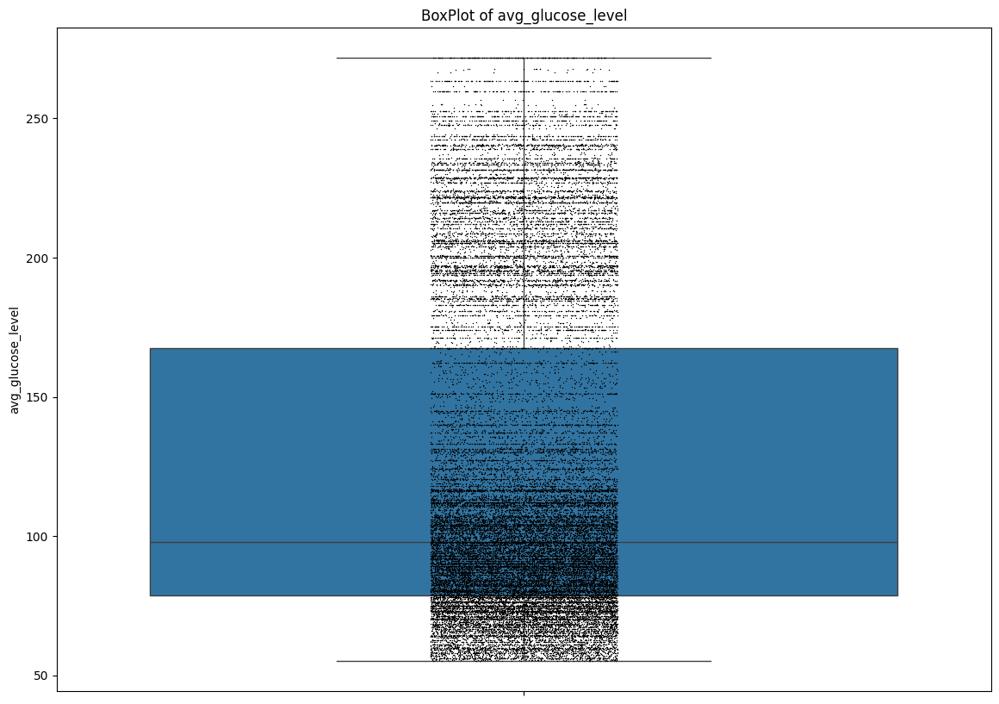

In [13]:
numerical_columns= ['bmi', 'age', 'avg_glucose_level']
for col in numerical_columns:
    plt.figure(figsize=(14,10))
    sns.boxplot(df[col])
    sns.stripplot( y=col, data=df, color='black', size=1, jitter=True)
    plt.title(f'BoxPlot of {col}')


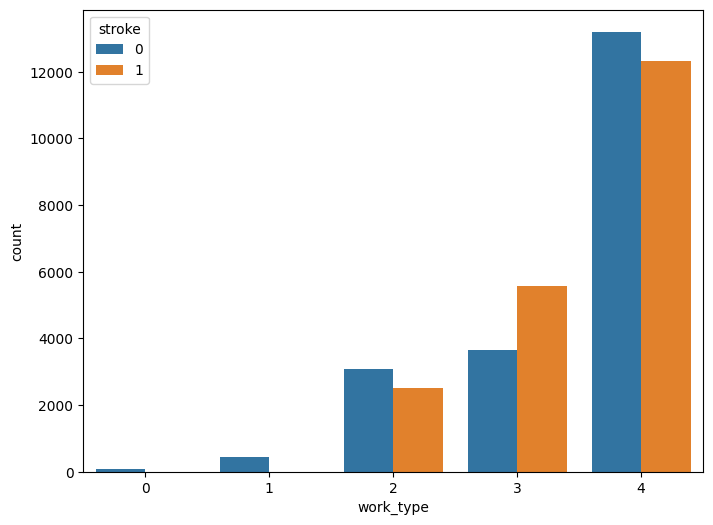

In [14]:
plt.figure(figsize=(8,6))
sns.countplot(x="work_type", hue='stroke', data=df)
plt.show()

In [15]:
from sklearn.model_selection import train_test_split
X=df.drop('stroke', axis=1)
y=df['stroke']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

In [16]:
from sklearn_pandas import gen_features
from sklearn_pandas import DataFrameMapper
from sklearn.preprocessing import StandardScaler, OneHotEncoder
# Визначення списку числових і категоріальних ознак
numeric_features = ['age', 'avg_glucose_level', 'bmi']
categorical_features = ['sex', 'hypertension', 'heart_disease','ever_married', 'Residence_type', 'smoking_status']

# Генерація функцій для мапера
numeric_transformations = gen_features(
    columns=[[col] for col in numeric_features],
    classes=[
        {'class': StandardScaler}
    ]
)

categorical_transformations = gen_features(
    columns=[['work_type']],
    classes=[OneHotEncoder]
)
categorical_f = gen_features(
    columns=[[col] for col in categorical_features]
)



In [17]:
from sklearn_pandas import DataFrameMapper
# Побудова мапера
preprocessor = DataFrameMapper(
    numeric_transformations + categorical_transformations+ categorical_f,
    df_out=True, default=False
)

# Навчання мапера на тренувальній вибірці та трансформація даних
preprocessor.fit(X_train)
X_train = preprocessor.transform(X_train)
X_test = preprocessor.transform(X_test)

In [18]:
print("X_train:")
print(X_train)

X_train:
            age  avg_glucose_level       bmi  work_type_0  work_type_1  \
17452  2.208114          -0.312457 -1.009192          0.0          0.0   
1422  -0.249808           1.562679  2.008288          0.0          0.0   
38392 -0.203432          -0.769257 -0.542722          0.0          0.0   
23564  0.260327          -1.021973 -0.498990          0.0          0.0   
35076 -2.012092          -0.744072 -0.207446          0.0          0.0   
...         ...                ...       ...          ...          ...   
10084 -1.455581           0.146427 -1.504817          0.0          0.0   
938   -2.151219           0.990203 -0.338641          0.0          0.0   
9447   0.863214           1.247609 -1.169541          0.0          0.0   
30494  1.048717          -0.304989 -0.586453          0.0          0.0   
11304 -0.991822          -0.312457 -1.009192          0.0          0.0   

       work_type_2  work_type_3  work_type_4  sex  hypertension  \
17452          0.0          1.0    

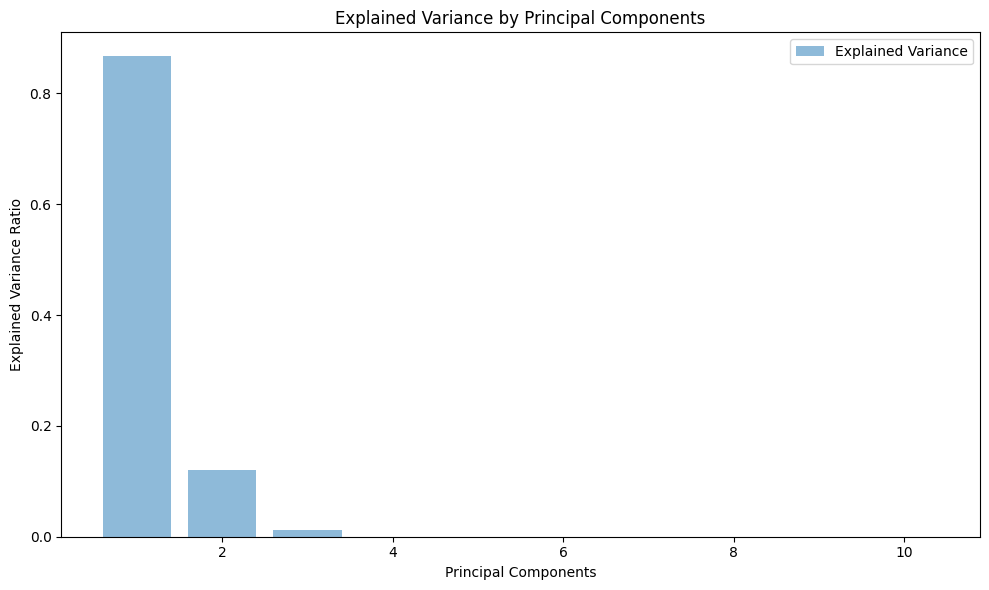

In [39]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np


# Навчання PCA моделі з усіма компонентами
pca0 = PCA()
X_pca0 = pca0.fit_transform(X)

# Аналіз explained variance
explained_variance = pca0.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance)

# Графік explained variance для кожної компоненти
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center', label='Explained Variance')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance by Principal Components')
plt.legend()
plt.tight_layout()
plt.show()



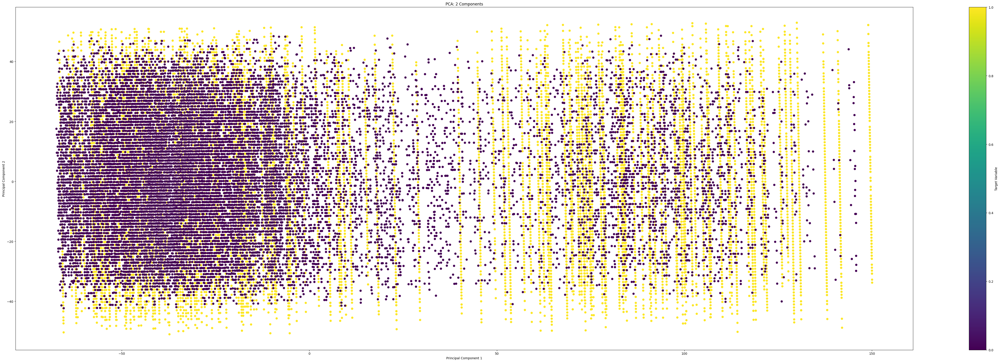

In [41]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from umap import UMAP
# Зменшення вимірності до двох компонент
pca = PCA(n_components=2)
X_pca_2d = pca.fit_transform(X)

# Візуалізація об'єктів у новому просторі
plt.figure(figsize=(50, 16))
plt.scatter(X_pca_2d[:, 0], X_pca_2d[:, 1], c=y, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA: 2 Components')
plt.colorbar(label='Target Variable')
plt.tight_layout()
plt.show()

In [21]:
pca.explained_variance_ratio_

array([0.86683413, 0.12122564])

In [22]:
from sklearn.manifold import TSNE
from umap import UMAP
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)


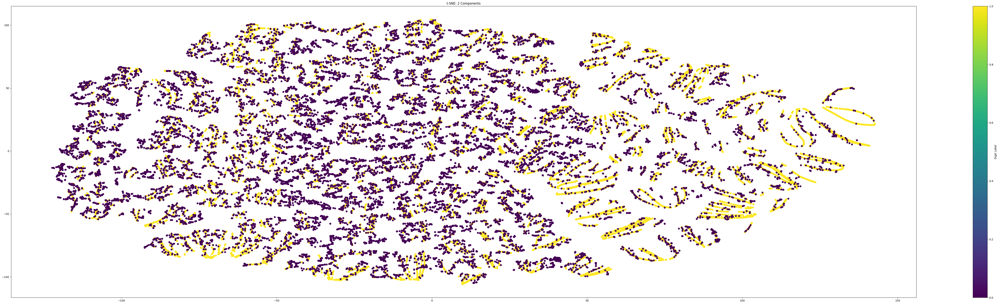

In [44]:
# Візуалізація результатів t-SNE
plt.figure(figsize=(60, 16))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y, cmap='viridis')
plt.title('t-SNE: 2 Components')
plt.colorbar(label='Digit Label')
plt.tight_layout()
plt.show()

In [24]:

tsne1 = TSNE(n_components=2,perplexity=5, random_state=42)
X_tsne1 = tsne1.fit_transform(X)


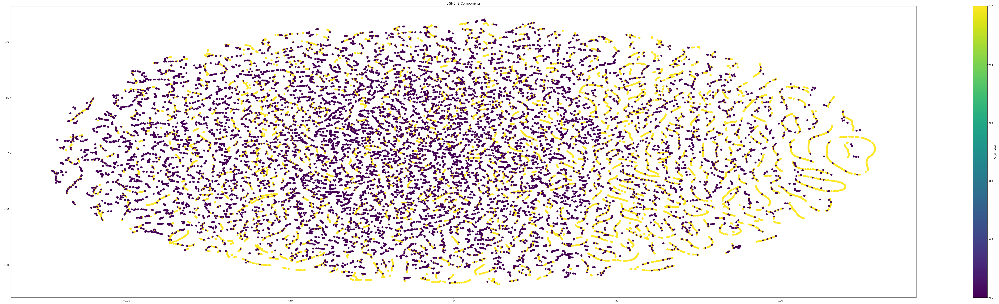

In [43]:
# Візуалізація результатів t-SNE
plt.figure(figsize=(60, 16))
plt.scatter(X_tsne1[:, 0], X_tsne1[:, 1], c=y, cmap='viridis')
plt.title('t-SNE: 2 Components')
plt.colorbar(label='Digit Label')
plt.tight_layout()
plt.show()

In [26]:
# Зменшення вимірності до 2 компонентів за допомогою UMAP
umap = UMAP(n_components=2, random_state=42)
X_umap = umap.fit_transform(X)

c:\Users\Admin\AppData\Local\Programs\Python\Python312\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [36]:
# Візуалізація результатів UMAP
plt.figure(figsize=(100, 60))
plt.scatter(X_umap[:, 0], X_umap[:, 1], c=y, cmap='viridis')
plt.title('UMAP: 2 Components')
plt.colorbar(label='Digit Label')
plt.tight_layout()
plt.show()

In [28]:
umap1 = UMAP(n_components=2,n_neighbors=5, random_state=42)
X_umap1 = umap1.fit_transform(X)

c:\Users\Admin\AppData\Local\Programs\Python\Python312\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [35]:
# Візуалізація результатів UMAP
plt.figure(figsize=(100, 60))
plt.scatter(X_umap1[:, 0], X_umap1[:, 1], c=y, cmap='viridis')
plt.title('UMAP: 2 Components')
plt.colorbar(label='Digit Label')
plt.tight_layout()
plt.show()

In [30]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

param_grid = {
    'penalty': ['l2',"l1"],
    'C': [0.001, 0.01, 0.1, 1, 10, 100]  
}

LG = LogisticRegression().fit(X_train, y_train)

grid_search1 = GridSearchCV(LogisticRegression(max_iter=10000), param_grid, cv=5)
grid_search1.fit(X_train, y_train)


best_mod = grid_search1.best_estimator_

print("Best Estimator:", best_mod)
print("Best score for SVC:", grid_search1.best_score_)

Best Estimator: LogisticRegression(C=0.01, max_iter=10000)
Best score for SVC: 0.6902788598710027


c:\Users\Admin\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning: 
30 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Admin\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Admin\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Admin\AppDat

In [31]:
from sklearn.metrics import log_loss, accuracy_score, precision_recall_fscore_support, roc_auc_score
y_pred = best_mod.predict(X_test)
# Обчислення точності (accuracy)
accuracy = accuracy_score(y_test, y_pred)


# Обчислення precision, recall, F₁-score
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='binary')


In [32]:
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
pipeline = Pipeline([('pca', PCA()), ('logistic', LogisticRegression(random_state=42))])

In [33]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

param_grid = {
    'pca__n_components': [2, 5, 10],  # Варіанти кількості компонент для PCA
    'logistic__C': [0.1, 1, 10]  # Регуляризаційний параметр логістичної регресії
}

grid_search_pca = GridSearchCV(pipeline, param_grid, cv=5, n_jobs=-1)
grid_search_pca.fit(X_train, y_train)

best_pipeline = grid_search_pca.best_estimator_

y_pred1 = best_pipeline.predict(X_test)

# Оцінка результатів
accuracy1 = accuracy_score(y_test, y_pred1)
precision1 = precision_score(y_test, y_pred1)
recall1 = recall_score(y_test, y_pred1)
f11 = f1_score(y_test, y_pred1)

print(f'Accuracy: {accuracy1}, Precision: {precision1}, Recall: {recall1}, F1-score: {f11}')

Accuracy: 0.6791090441806389, Precision: 0.6979647218453189, Recall: 0.6302376868414604, F1-score: 0.6623744527427247


In [34]:
data = {
    'Model': ['lr', 'lr_pca'],
    'Accuracy': [accuracy, accuracy1],
    'Precision': [precision, precision1],
    'Recall': [recall, recall1],
    'F1-score': [f1, f11]
}
metrics_df = pd.DataFrame(data)

# Вивід таблиці
print(metrics_df)

    Model  Accuracy  Precision    Recall  F1-score
0      lr  0.686697   0.707617  0.635138  0.669421
1  lr_pca  0.679109   0.697965  0.630238  0.662374
